Нейронный перенос стиля с Pytorch
============================
**Aвтор**: `Alexis Jacq <https://alexis-jacq.github.io>` <br />
**Адаптивный перевод**: `Zueva Nadya <https://github.com/nestyme>` <br />
Введение
------------

В этом ноутбуке объясняется и показывается, как работает алгоритм переноса стиля 

`Neural-Style <https://arxiv.org/abs/1508.06576>` 

Леона А. Гатиса, Александра С. Эккера и Маттиаса Бетге.


**Нейронный перенос стиля** -- это алгоритм, который принимает контент-изображение (например, черепаху), стиль-изображение (например, картинку известного художника) и возвращает изображение, которое будто бы нарисовано тем художником:



**Как это работает?**

Всего есть три картинки: вход, стиль и контент. 
Определим два расстояния: 
- $D_S$ - оно определяет на сколько разные стили у двух произвольных картинок.
- $D_C$ - оно определяет на сколько разнится контент у двух произвольных картинок.

задача сети - минимизировать $D_S$ от входной картинки до стиля и $D_C$ от входной картиники до контента.<br />
В качестве входа обычно берется зашумленная к
артинка контента.


Это все что нам понадобится:

In [1]:
!pip3 install torch torchvision
#!pip3 install pillow==4.1.1

In [2]:
!wget https://www.dropbox.com/s/afqhab9zc9r8otb/images.zip?dl=1
!mv images.zip?dl=1 images.zip
!unzip images.zip

--2020-06-08 12:38:43--  https://www.dropbox.com/s/afqhab9zc9r8otb/images.zip?dl=1
Resolving www.dropbox.com (www.dropbox.com)... 162.125.67.1, 2620:100:6023:1::a27d:4301
Connecting to www.dropbox.com (www.dropbox.com)|162.125.67.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/dl/afqhab9zc9r8otb/images.zip [following]
--2020-06-08 12:38:44--  https://www.dropbox.com/s/dl/afqhab9zc9r8otb/images.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc2837e4903a11abfc58eba6f62d.dl.dropboxusercontent.com/cd/0/get/A5RTj7IY5bVRAxXF9MqxX9d0QurUockVeXnZFuBNbhzmDSA00JWpekHzvKngGwXM0mvPN06HDO2Wxh9W2PcfydFWqpeMHcVw-Yt-TSAde7mLfcWkwOx5f651CRuaVLT7FaM/file?dl=1# [following]
--2020-06-08 12:38:44--  https://uc2837e4903a11abfc58eba6f62d.dl.dropboxusercontent.com/cd/0/get/A5RTj7IY5bVRAxXF9MqxX9d0QurUockVeXnZFuBNbhzmDSA00JWpekHzvKngGwXM0mvPN06HDO2Wxh9W2PcfydFWqpeMHcVw-Yt-TSAde7mLfcWkwOx

In [0]:
%matplotlib inline
from PIL import Image


import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

import matplotlib.pyplot as plt


import torchvision.transforms as transforms
import torchvision.models as models

import copy

In [4]:
!ls images/

content.jpg  first_style.jpg  second_style.jpg


**Загрузка изображений**

Нам понадобятся картинки стиля и контента, так что загрузим их.<br />
Чтобы упростить реализацию, начнем с контента и стиля одного размера. Затем мы масштабируем их до требуемых размеров выходного изображения.

Примеры изображений лежат в папке `Images` на гуглдиске

Вы можете добавить туда свои собственные изображения -- главное, чтобы они были одного размера

In [0]:
imsize = 512 

loader = transforms.Compose([
    transforms.Resize(imsize),  # нормируем размер изображения
    transforms.CenterCrop(imsize),
    transforms.ToTensor()])  # превращаем в удобный формат

In [0]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
def image_loader(image_name):
    image = Image.open(image_name)
    image = loader(image).unsqueeze(0)
    return image.to(device, torch.float)


#content_img = image_loader("images/picasso.jpg")# as well as here
#style_img = image_loader("images/lisa.jpg")#измените путь на тот который у вас.
#style_img = image_loader("images/picasso.jpg")# as well as here
#style_img_second = image_loader("images/second.jpg")# as well as here
#content_img = image_loader("images/lisa.jpg")#измените путь на тот который у вас.

In [22]:
#!wget https://museum-design.ru/wp-content/uploads/i-scott-05.jpg -O /content/images/first_style.jpg
# ТУТ КРАСНЫЙ КВАДРАТ
#!wget https://art-holst.com.ua/wp-content/uploads/thumb_l_28551.jpg -O /content/images/second_style.jpg
#!wget https://storge.pic2.me/c/1360x800/721/59aea1186a1bf.jpg -O /content/images/content.jpg

#!wget https://vestikavkaza.ru/upload/2019-12-18/15767022705dfa913e619de3.24454359.jpg -O /content/images/second_style.jpg

--2020-06-08 10:41:40--  https://museum-design.ru/wp-content/uploads/i-scott-05.jpg
Resolving museum-design.ru (museum-design.ru)... 5.9.57.100
Connecting to museum-design.ru (museum-design.ru)|5.9.57.100|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 561477 (548K) [image/jpeg]
Saving to: ‘/content/images/first_style.jpg’

/content/images/fir 100%[===================>] 548.32K  --.-KB/s    in 0.1s    

2020-06-08 10:41:41 (4.88 MB/s) - ‘/content/images/first_style.jpg’ saved [561477/561477]

--2020-06-08 10:41:43--  https://art-holst.com.ua/wp-content/uploads/thumb_l_28551.jpg
Resolving art-holst.com.ua (art-holst.com.ua)... 104.26.3.77, 104.26.2.77, 172.67.73.50, ...
Connecting to art-holst.com.ua (art-holst.com.ua)|104.26.3.77|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 132670 (130K) [image/jpeg]
Saving to: ‘/content/images/second_style.jpg’

/content/images/sec 100%[===================>] 129.56K  --.-KB/s    in 0.01s   

2020-

In [0]:
#content_img = image_loader("images/picasso.jpg")# as well as here
#style_img = image_loader("images/lisa.jpg")#измените путь на тот который у вас.
style_img = image_loader("images/first_style.jpg")# as well as here
style_img_second = image_loader("images/second_style.jpg")# as well as here
content_img = image_loader("images/content.jpg")#измените путь на тот который у вас.

Выведем то, что было загружено

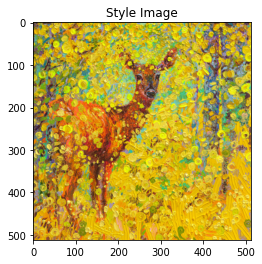

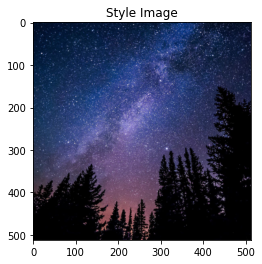

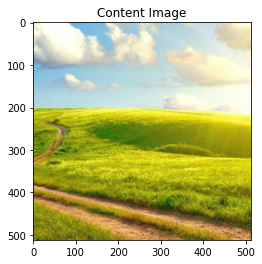

In [8]:
unloader = transforms.ToPILImage() # тензор в кратинку  

plt.ion() 

def imshow(tensor, title=None):
    image = tensor.cpu().clone()   
    image = image.squeeze(0)      # функция для отрисовки изображения
    image = unloader(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)
    plt.pause(0.001) 

def tensor_to_matrix(tensor):
    # plt.figure(figsize=(10,10))
    image = tensor.cpu().clone()   
    image = image.squeeze(0)      # функция для отрисовки изображения
    image = unloader(image)
    return image

# отрисовка

plt.figure()
imshow(style_img, title='Style Image')

plt.figure()
imshow(style_img_second, title='Style Image')


plt.figure()
imshow(content_img, title='Content Image')


Теперь нужно создать функции, которые будут вычислять расстояния ( $D_C$ и $D_S$). <br />
Они будут выполенены в виде слоев, чтобы брать по ним автоградиент.

$D_S$ - средняя квадратичная ощибка input'а и target'а

In [0]:
class ContentLoss(nn.Module):

        def __init__(self, target,):
            super(ContentLoss, self).__init__()
            # we 'detach' the target content from the tree used
            # to dynamically compute the gradient: this is a stated value,
            # not a variable. Otherwise the forward method of the criterion
            # will throw an error.
            self.target = target.detach()#это константа. Убираем ее из дерева вычеслений
            self.loss = F.mse_loss(self.target, self.target )#to initialize with something

        def forward(self, input):
            self.loss = F.mse_loss(input, self.target)
            return input

Матрица грама позволяет учесть не только сами значения feature map'а, но и кореляцию фич друг с другом. <br /> Это нужно для того, чтобы сделать акцент на встречаемость фич с друг другом, а не на их геометрическом положении. <br />
Полное понимание этого момента можно получить с помощью [этого](https://arxiv.org/pdf/1508.06576.pdf)  и [этого](https://m.habr.com/company/mailru/blog/306916/).

Таким образом:

$D_S$  = $\sum$($G_{ij}$($img_1$) - $G_{ij}$($img_2$)$)^{2}$

Сначала задаем спрособ подсчета матрицы грама: Это просто тензорное тензорное произведение вектора выхода уровня самого на себя.<br /> Однка наш выход - не вектор. В этом случае операция тоже возможна,<br /> но мы получим тензор третьего ранга. Поэтому перед перемножением выход нужно привести к форме вектора.<br />

In [0]:
def gram_matrix(input):
        batch_size , f_map_num, h, w = input.size()  # batch size(=1)
        #print("gram_matrix =" , batch_size, f_map_num, h, w)
        # b=number of feature maps
        # (h,w)=dimensions of a feature map (N=h*w)

        features = input.view(batch_size * f_map_num, w * h)  # resise F_XL into \hat F_XL

        G = torch.mm(features, features.t())  # compute the gram product

        # we 'normalize' the values of the gram matrix
        # by dividing by the number of element in each feature maps.
        return G.div(batch_size * h * w * f_map_num)

Матрица грама готова, теперь нужно лишь реализовать MSE

In [0]:
class StyleLoss(nn.Module):
        def __init__(self, target_feature):
            super(StyleLoss, self).__init__()
            self.target = gram_matrix(target_feature).detach()
            self.loss = F.mse_loss(self.target, self.target)# to initialize with something

        def forward(self, input):
            G = gram_matrix(input)
            self.loss = F.mse_loss(G, self.target)
            return input

При тренировке VGG каждое изображение на котором она обучалась было нормировано по всем каналам (RGB). Если мы хотим изпользовать ее для нашей модели, то мы должны реализовать нормировку и для наших изображений тоже.


In [0]:
cnn_normalization_mean = torch.tensor([0.485, 0.456, 0.406]).to(device)
cnn_normalization_std = torch.tensor([0.229, 0.224, 0.225]).to(device)

In [0]:
class Normalization(nn.Module):
        def __init__(self, mean, std):
            super(Normalization, self).__init__()
            # .view the mean and std to make them [C x 1 x 1] so that they can
            # directly work with image Tensor of shape [B x C x H x W].
            # B is batch size. C is number of channels. H is height and W is width.
            self.mean = torch.tensor(mean).view(-1, 1, 1)
            self.std = torch.tensor(std).view(-1, 1, 1)

        def forward(self, img):
            # normalize img
            return (img - self.mean) / self.std

Теперь соберем это все в одну функцию, которая отдаст на выходе модель и две функции потерь 

Определим после каких уровней мы будем счиатать ошибки стиля, а после каких ошибки контента

In [0]:
content_layers_default = ['conv_4']
style_layers_default = ['conv_1', 'conv_2', 'conv_3', 'conv_4', 'conv_5']

Определим предобученную модель

In [15]:
cnn = models.vgg19(pretrained=True).features.to(device).eval()

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/checkpoints/vgg19-dcbb9e9d.pth


In [0]:
def get_style_model_and_losses(cnn, normalization_mean, normalization_std,
                                   style_img, style_img_second, content_img,
                                   content_layers=content_layers_default,
                                   style_layers=style_layers_default):
        cnn = copy.deepcopy(cnn)

        # normalization module
        normalization = Normalization(normalization_mean, normalization_std).to(device)

        # just in order to have an iterable access to or list of content/syle
        # losses
        content_losses = []
        style_losses = []
        style_losses_second = []

        # assuming that cnn is a nn.Sequential, so we make a new nn.Sequential
        # to put in modules that are supposed to be activated sequentially
        model = nn.Sequential(normalization)

        i = 0  # increment every time we see a conv
        for layer in cnn.children():
            if isinstance(layer, nn.Conv2d):
                i += 1
                name = 'conv_{}'.format(i)
            elif isinstance(layer, nn.ReLU):
                name = 'relu_{}'.format(i)
                # The in-place version doesn't play very nicely with the ContentLoss
                # and StyleLoss we insert below. So we replace with out-of-place
                # ones here.
                #Переопределим relu уровень
                layer = nn.ReLU(inplace=False)
            elif isinstance(layer, nn.MaxPool2d):
                name = 'pool_{}'.format(i)
            elif isinstance(layer, nn.BatchNorm2d):
                name = 'bn_{}'.format(i)
            else:
                raise RuntimeError('Unrecognized layer: {}'.format(layer.__class__.__name__))

            model.add_module(name, layer)

            if name in content_layers:
                # add content loss:
                target = model(content_img).detach()
                content_loss = ContentLoss(target)
                model.add_module("content_loss_{}".format(i), content_loss)
                content_losses.append(content_loss)

            if name in style_layers:
                # add style loss:
                target_feature = model(style_img).detach()
                style_loss = StyleLoss(target_feature)
                model.add_module("style_loss_{}".format(i), style_loss)
                style_losses.append(style_loss)

                # add style loss:
                target_feature_second = model(style_img_second).detach()
                style_loss_second = StyleLoss(target_feature_second)
                model.add_module("style_loss_second_{}".format(i), style_loss_second)
                style_losses_second.append(style_loss_second)

        # now we trim off the layers after the last content and style losses
        #выбрасываем все уровни после последенего styel loss или content loss
        for i in range(len(model) - 1, -1, -1):
            if isinstance(model[i], ContentLoss) or isinstance(model[i], StyleLoss):
                break

        model = model[:(i + 1)]

        return model, style_losses, style_losses_second, content_losses

In [0]:
def get_input_optimizer(input_img):
        # this line to show that input is a parameter that requires a gradient
        #добоваляет содержимое тензора катринки в список изменяемых оптимизатором параметров
        #optimizer = optim.LBFGS([input_img.requires_grad_()]) 
        #optimizer = optim.LBFGS([input_img.requires_grad_()])
        optimizer = torch.optim.Adam([input_img.requires_grad_()])
        return optimizer

Дальше стандартный цикл обучения, но что это за closure?<br /> Это функция, которая вызывается во время каждого прохода, чтобы пересчитать loss. Без нее ничего не получется так как у нас своя функция ошибки

In [0]:
def run_style_transfer(cnn, normalization_mean, normalization_std,
                        content_img, style_img, style_img_second, input_img, num_steps=500,
                        style_weight=100000, content_weight=1, alpha_coefficient=0.1):
                        #style_weight=1, content_weight=100000):
        """Run the style transfer."""
        print('Building the style transfer model..')
        model, style_losses, style_losses_second, content_losses = get_style_model_and_losses(cnn,
            normalization_mean, normalization_std, style_img, style_img_second, content_img)
        optimizer = get_input_optimizer(input_img)


        print('Optimizing..')
        run = [0]
        while run[0] <= num_steps:

            def closure():
                # correct the values 
                # это для того, чтобы значения тензора картинки не выходили за пределы [0;1]
                input_img.data.clamp_(0, 1)

                optimizer.zero_grad()

                model(input_img)

                style_score = 0
                style_score_second = 0
                content_score = 0

                for sl in style_losses:
                    style_score += sl.loss
                for sl_second in style_losses_second:
                    style_score_second += sl_second.loss 
                for cl in content_losses:
                    content_score += cl.loss
                
                
                #взвешивание ощибки
                style_score *= (style_weight * (1 - alpha_coefficient))
                style_score_second *= (style_weight * alpha_coefficient)
                content_score *= content_weight

                loss = style_score + style_score_second + content_score
                loss.backward()

                run[0] += 1
                if run[0] % 50 == 0:
                    print("run {}:".format(run))
                    print('Style Loss : {:4f} Style-Second Loss : {:4f} Content Loss: {:4f}'.format(
                        style_score.item(), style_score_second.item(), content_score.item()))
                    print()
                    plt.figure()
                    imshow(input_img, title='Output Image')
                    plt.ioff()
                    plt.show()

                return style_score + style_score_second + content_score

            optimizer.step(closure)

        # a last correction...
        input_img.data.clamp_(0, 1)

        return input_img

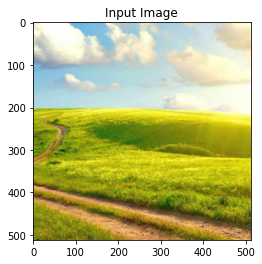

Building the style transfer model..
Optimizing..


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  import sys
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  


run [50]:
Style Loss : 1385.941162 Style-Second Loss : 991.702942 Content Loss: 8.912428



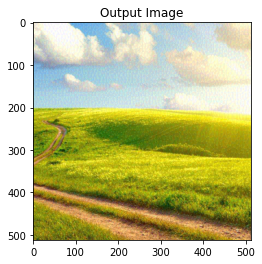

run [100]:
Style Loss : 1323.689087 Style-Second Loss : 900.548035 Content Loss: 11.816435



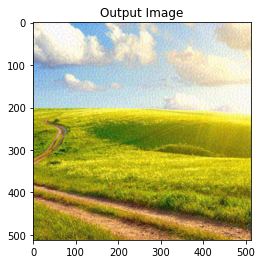

run [150]:
Style Loss : 1316.747070 Style-Second Loss : 836.502747 Content Loss: 13.192642



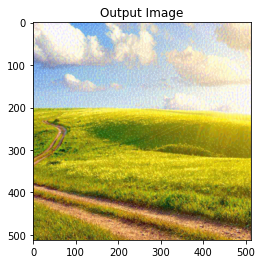

run [200]:
Style Loss : 1317.272339 Style-Second Loss : 793.015808 Content Loss: 14.105225



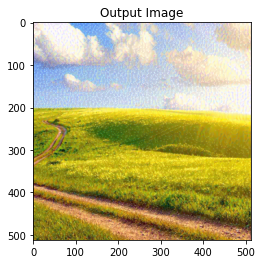

run [250]:
Style Loss : 1320.058350 Style-Second Loss : 761.951172 Content Loss: 14.747772



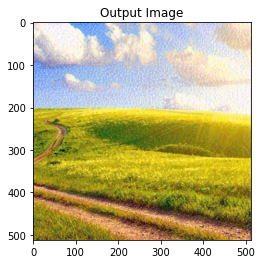

run [300]:
Style Loss : 1323.468750 Style-Second Loss : 738.644165 Content Loss: 15.224835



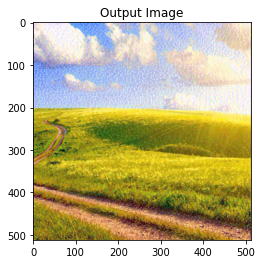

run [350]:
Style Loss : 1327.009888 Style-Second Loss : 720.307129 Content Loss: 15.594793



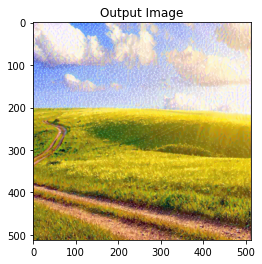

run [400]:
Style Loss : 1330.464233 Style-Second Loss : 705.446411 Content Loss: 15.890959



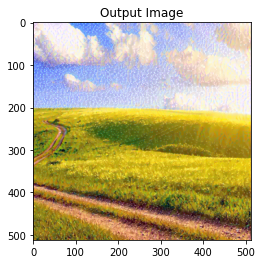

run [450]:
Style Loss : 1333.833252 Style-Second Loss : 693.079529 Content Loss: 16.129791



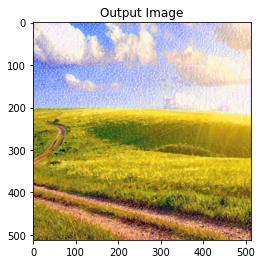

run [500]:
Style Loss : 1337.081299 Style-Second Loss : 682.613037 Content Loss: 16.322048



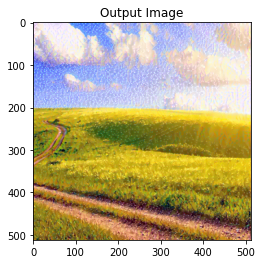

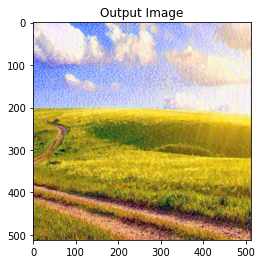

In [19]:
input_img = content_img.clone()
# if you want to use white noise instead uncomment the below line:
#input_img = torch.randn(content_img.data.size(), device=device)

# add the original input image to the figure:
plt.figure()
imshow(input_img, title='Input Image')
output = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, style_img_second, input_img, alpha_coefficient=0.7)

plt.figure()
imshow(output, title='Output Image')
#plt.imsave(output, 'output.png')
# sphinx_gallery_thumbnail_number = 4
plt.ioff()
plt.show()

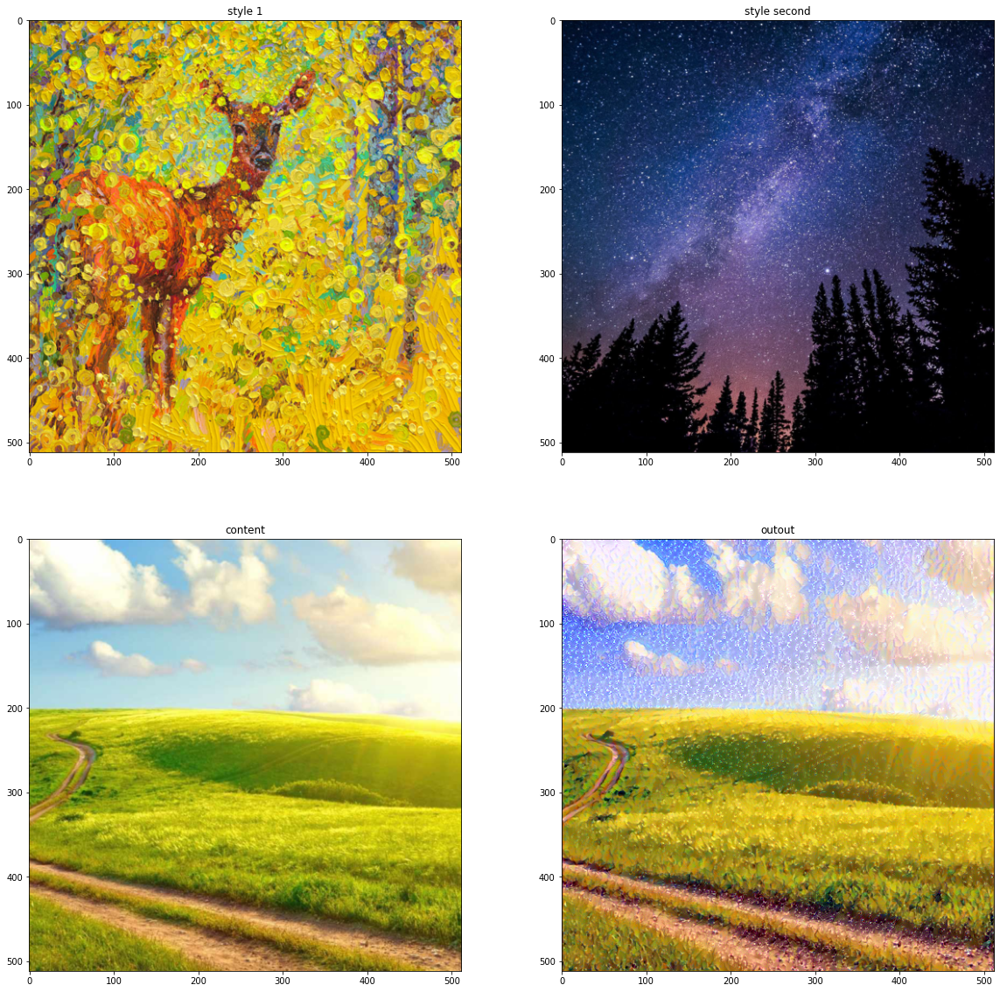

In [20]:
fig = plt.figure(figsize=(20,20), )

plt.subplot(2, 2, 1)
plt.title('style 1')
plt.imshow(tensor_to_matrix(style_img))

plt.subplot(2, 2, 2)
plt.title('style second')
plt.imshow(tensor_to_matrix(style_img_second))

plt.subplot(2, 2, 3)
plt.title('content')
plt.imshow(tensor_to_matrix(content_img))

plt.subplot(2, 2, 4)
plt.title('outout')
plt.imshow(tensor_to_matrix(output))


plt.ioff()
plt.show()

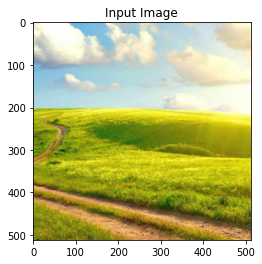

Building the style transfer model..
Optimizing..


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  import sys
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  


run [50]:
Style Loss : 1407.555054 Style-Second Loss : 1372.163330 Content Loss: 10.413445



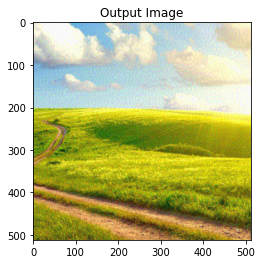

run [100]:
Style Loss : 1225.127075 Style-Second Loss : 1351.886108 Content Loss: 14.330048



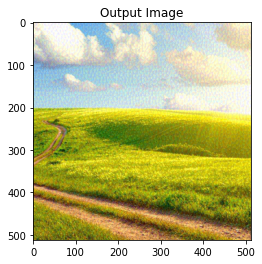

run [150]:
Style Loss : 1185.430664 Style-Second Loss : 1324.331177 Content Loss: 15.677208



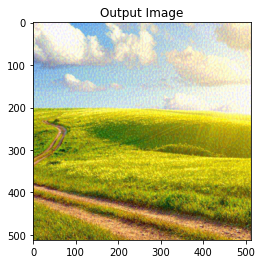

run [200]:
Style Loss : 1167.370728 Style-Second Loss : 1301.530151 Content Loss: 16.625723



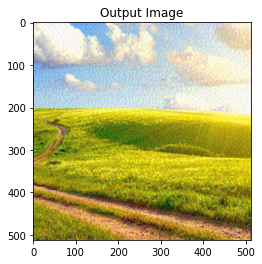

run [250]:
Style Loss : 1157.950439 Style-Second Loss : 1283.749390 Content Loss: 17.306702



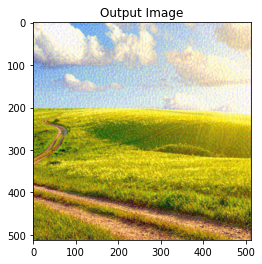

run [300]:
Style Loss : 1153.011719 Style-Second Loss : 1269.721191 Content Loss: 17.807995



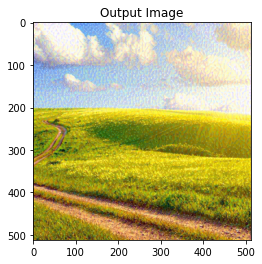

run [350]:
Style Loss : 1150.686768 Style-Second Loss : 1258.341431 Content Loss: 18.183350



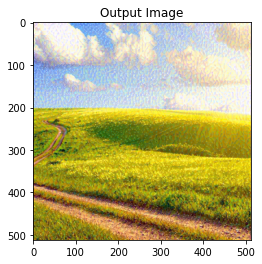

run [400]:
Style Loss : 1149.900513 Style-Second Loss : 1248.874390 Content Loss: 18.467407



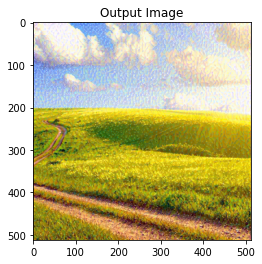

run [450]:
Style Loss : 1149.979736 Style-Second Loss : 1240.857910 Content Loss: 18.684111



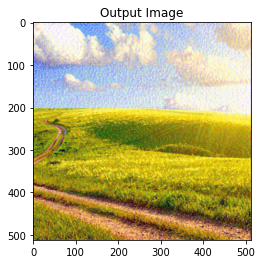

run [500]:
Style Loss : 1150.554321 Style-Second Loss : 1233.952515 Content Loss: 18.850777



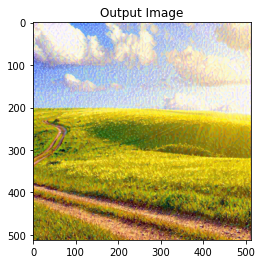

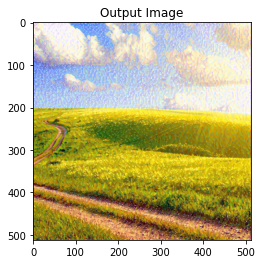

In [21]:
input_img = content_img.clone()
# if you want to use white noise instead uncomment the below line:
#input_img = torch.randn(content_img.data.size(), device=device)

# add the original input image to the figure:
plt.figure()
imshow(input_img, title='Input Image')
output = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, style_img_second, input_img, alpha_coefficient=0.5)

plt.figure()
imshow(output, title='Output Image')
#plt.imsave(output, 'output.png')
# sphinx_gallery_thumbnail_number = 4
plt.ioff()
plt.show()

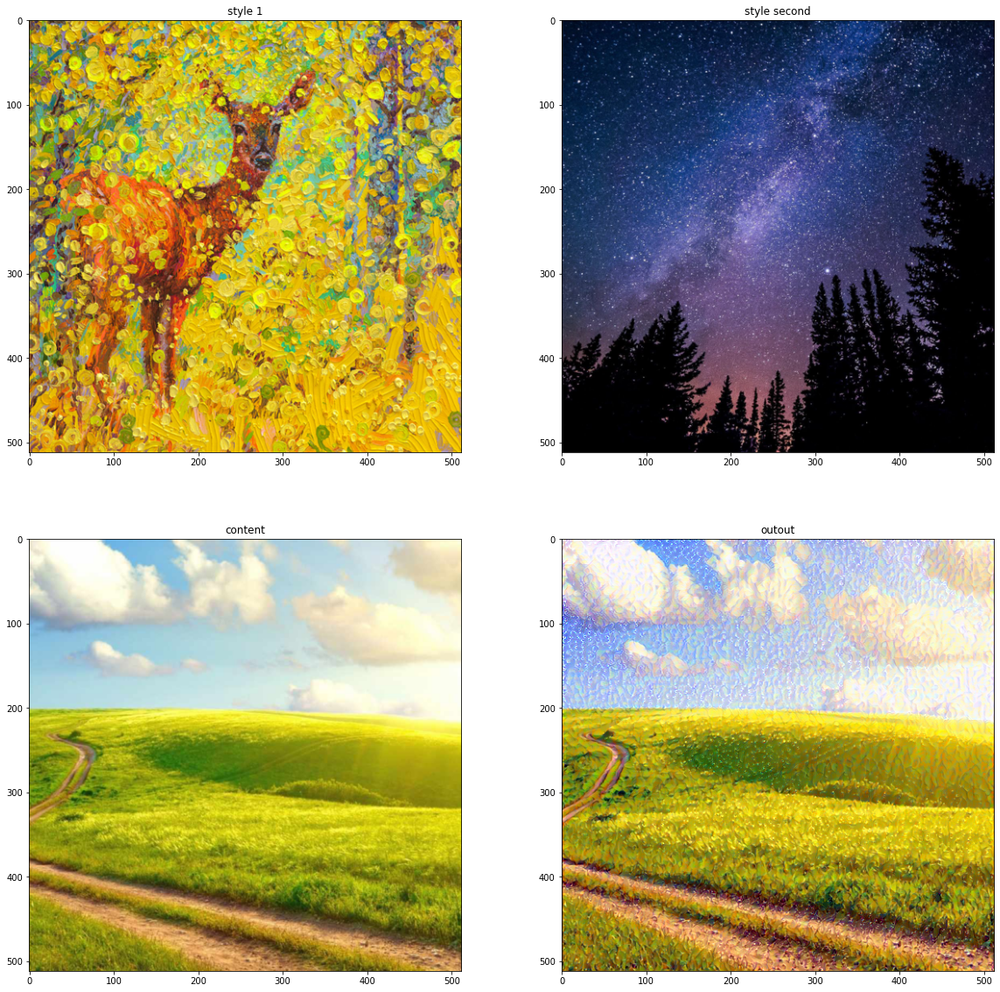

In [22]:
fig = plt.figure(figsize=(20,20), )

plt.subplot(2, 2, 1)
plt.title('style 1')
plt.imshow(tensor_to_matrix(style_img))

plt.subplot(2, 2, 2)
plt.title('style second')
plt.imshow(tensor_to_matrix(style_img_second))

plt.subplot(2, 2, 3)
plt.title('content')
plt.imshow(tensor_to_matrix(content_img))

plt.subplot(2, 2, 4)
plt.title('outout')
plt.imshow(tensor_to_matrix(output))


plt.ioff()
plt.show()

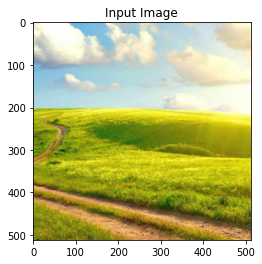

Building the style transfer model..
Optimizing..


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  import sys
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  


run [50]:
Style Loss : 1374.296387 Style-Second Loss : 1000.159058 Content Loss: 12.551134



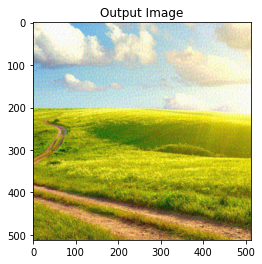

run [100]:
Style Loss : 694.929199 Style-Second Loss : 1132.080078 Content Loss: 18.900028



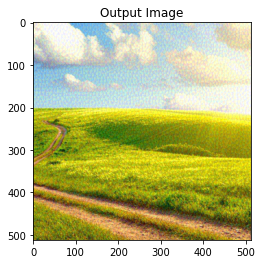

run [150]:
Style Loss : 548.082275 Style-Second Loss : 1167.174683 Content Loss: 21.224331



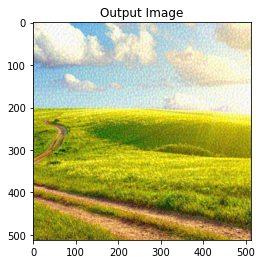

run [200]:
Style Loss : 480.665405 Style-Second Loss : 1179.432861 Content Loss: 22.472458



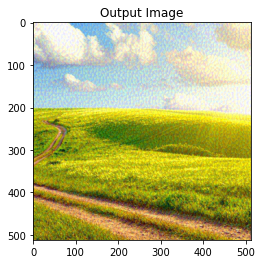

run [250]:
Style Loss : 438.569366 Style-Second Loss : 1186.236206 Content Loss: 23.346367



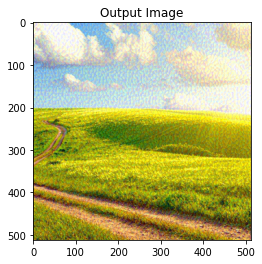

run [300]:
Style Loss : 409.905457 Style-Second Loss : 1190.224976 Content Loss: 23.982220



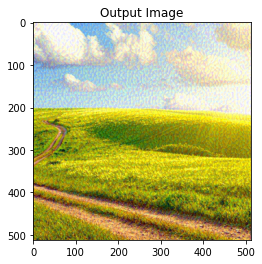

run [350]:
Style Loss : 389.535156 Style-Second Loss : 1192.620972 Content Loss: 24.453384



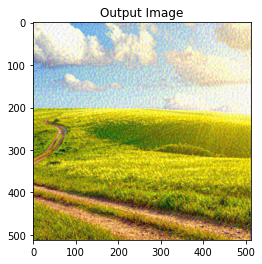

run [400]:
Style Loss : 374.901550 Style-Second Loss : 1193.886963 Content Loss: 24.804613



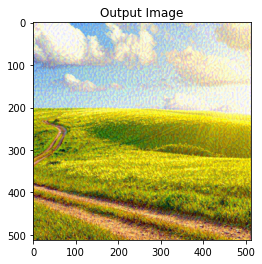

run [450]:
Style Loss : 364.102570 Style-Second Loss : 1194.523560 Content Loss: 25.067974



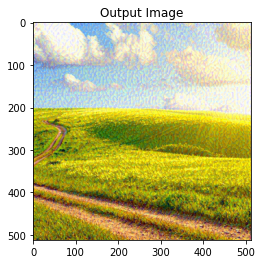

run [500]:
Style Loss : 356.037628 Style-Second Loss : 1194.721802 Content Loss: 25.264849



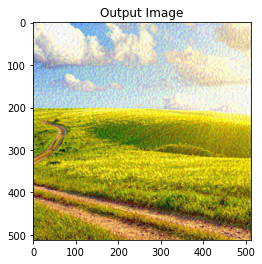

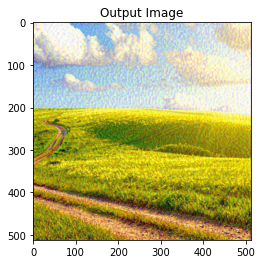

In [23]:
input_img = content_img.clone()
# if you want to use white noise instead uncomment the below line:
#input_img = torch.randn(content_img.data.size(), device=device)

# add the original input image to the figure:
plt.figure()
imshow(input_img, title='Input Image')
output = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, style_img_second, input_img, alpha_coefficient=0.2)

plt.figure()
imshow(output, title='Output Image')
#plt.imsave(output, 'output.png')
# sphinx_gallery_thumbnail_number = 4
plt.ioff()
plt.show()

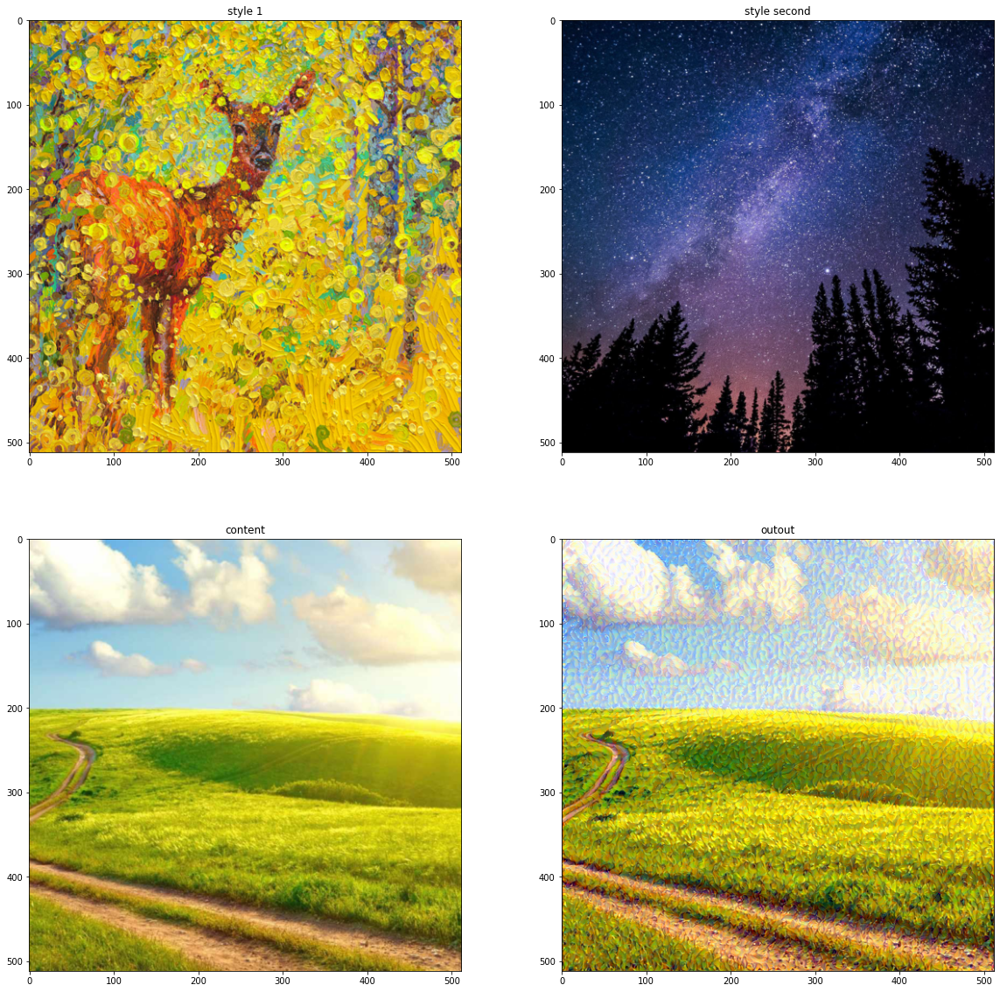

In [24]:
fig = plt.figure(figsize=(20,20), )

plt.subplot(2, 2, 1)
plt.title('style 1')
plt.imshow(tensor_to_matrix(style_img))

plt.subplot(2, 2, 2)
plt.title('style second')
plt.imshow(tensor_to_matrix(style_img_second))

plt.subplot(2, 2, 3)
plt.title('content')
plt.imshow(tensor_to_matrix(content_img))

plt.subplot(2, 2, 4)
plt.title('outout')
plt.imshow(tensor_to_matrix(output))


plt.ioff()
plt.show()

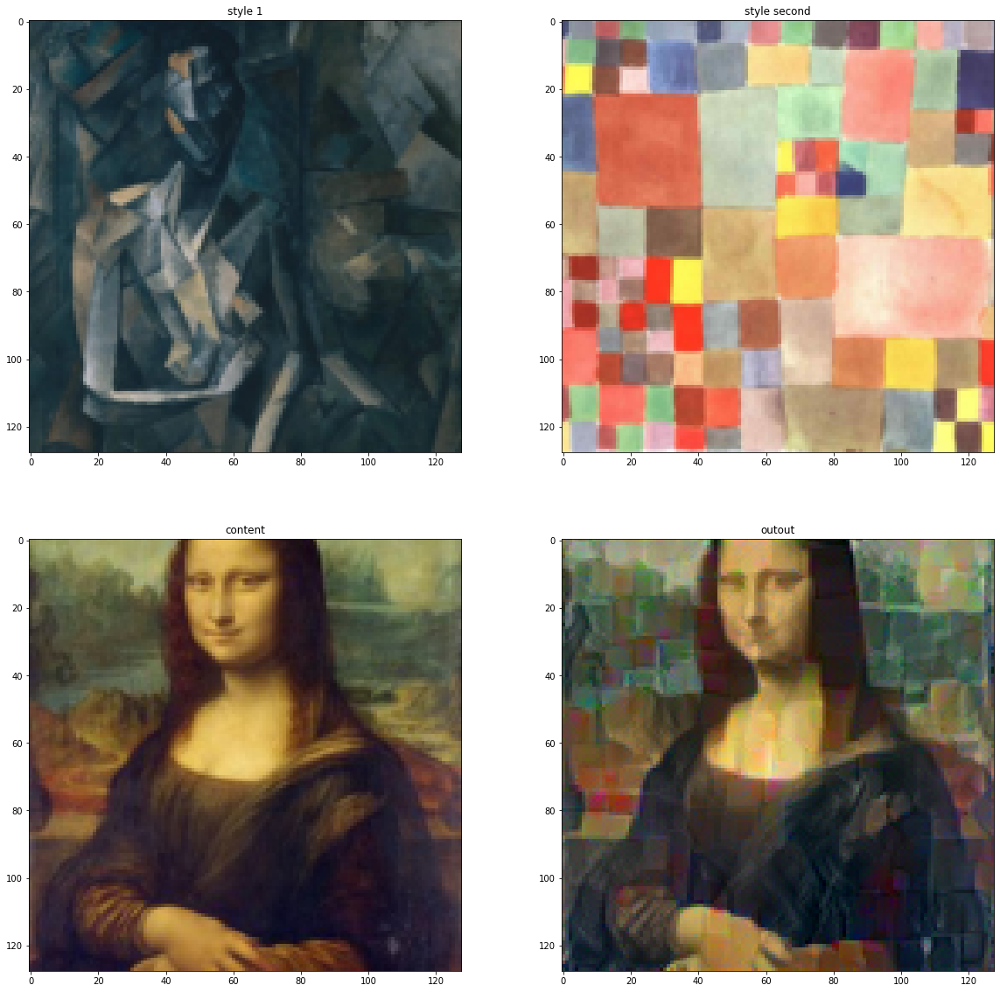

In [0]:
fig = plt.figure(figsize=(20,20), )

plt.subplot(2, 2, 1)
plt.title('style 1')
plt.imshow(tensor_to_matrix(style_img))

plt.subplot(2, 2, 2)
plt.title('style second')
plt.imshow(tensor_to_matrix(style_img_second))

plt.subplot(2, 2, 3)
plt.title('content')
plt.imshow(tensor_to_matrix(content_img))

plt.subplot(2, 2, 4)
plt.title('outout')
plt.imshow(tensor_to_matrix(output))


plt.ioff()
plt.show()

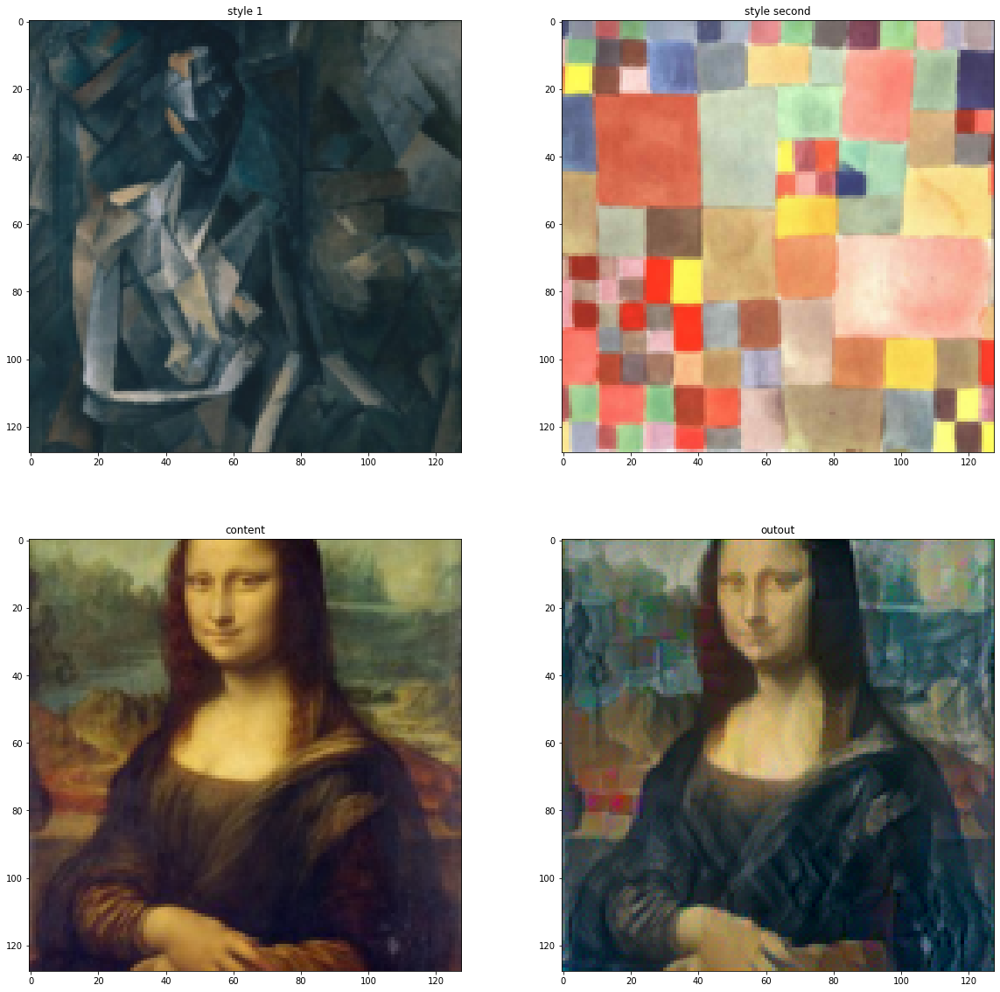

In [0]:
fig = plt.figure(figsize=(20,20), )

plt.subplot(2, 2, 1)
plt.title('style 1')
plt.imshow(tensor_to_matrix(style_img))

plt.subplot(2, 2, 2)
plt.title('style second')
plt.imshow(tensor_to_matrix(style_img_second))

plt.subplot(2, 2, 3)
plt.title('content')
plt.imshow(tensor_to_matrix(content_img))

plt.subplot(2, 2, 4)
plt.title('outout')
plt.imshow(tensor_to_matrix(output))


plt.ioff()
plt.show()

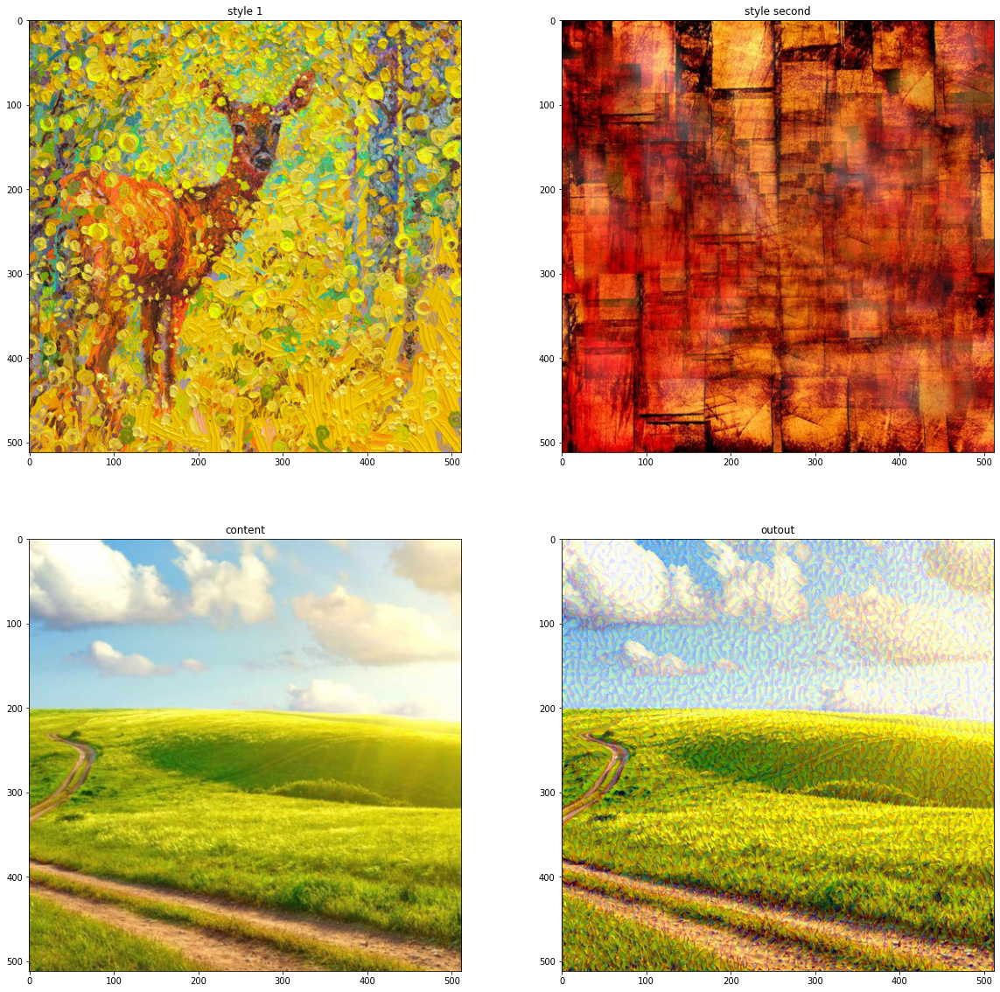

In [0]:
fig = plt.figure(figsize=(20,20), )

plt.subplot(2, 2, 1)
plt.title('style 1')
plt.imshow(tensor_to_matrix(style_img))

plt.subplot(2, 2, 2)
plt.title('style second')
plt.imshow(tensor_to_matrix(style_img_second))

plt.subplot(2, 2, 3)
plt.title('content')
plt.imshow(tensor_to_matrix(content_img))

plt.subplot(2, 2, 4)
plt.title('outout')
plt.imshow(tensor_to_matrix(output))


plt.ioff()
plt.show()

In [25]:
!wget https://art-holst.com.ua/wp-content/uploads/thumb_l_28551.jpg -O /content/images/second_style.jpg
#content_img = image_loader("images/picasso.jpg")# as well as here
#style_img = image_loader("images/lisa.jpg")#измените путь на тот который у вас.
style_img = image_loader("images/first_style.jpg")# as well as here
style_img_second = image_loader("images/second_style.jpg")# as well as here
content_img = image_loader("images/content.jpg")#измените путь на тот который у вас.

--2020-06-08 12:47:48--  https://art-holst.com.ua/wp-content/uploads/thumb_l_28551.jpg
Resolving art-holst.com.ua (art-holst.com.ua)... 104.26.2.77, 104.26.3.77, 172.67.73.50, ...
Connecting to art-holst.com.ua (art-holst.com.ua)|104.26.2.77|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 132670 (130K) [image/jpeg]
Saving to: ‘/content/images/second_style.jpg’

/content/images/sec 100%[===================>] 129.56K  --.-KB/s    in 0.01s   

2020-06-08 12:47:48 (9.22 MB/s) - ‘/content/images/second_style.jpg’ saved [132670/132670]



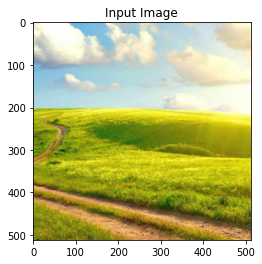

Building the style transfer model..
Optimizing..


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  import sys
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  


run [50]:
Style Loss : 925.621704 Style-Second Loss : 920.530579 Content Loss: 8.699196



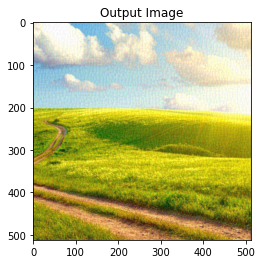

run [100]:
Style Loss : 885.705261 Style-Second Loss : 809.648438 Content Loss: 11.167154



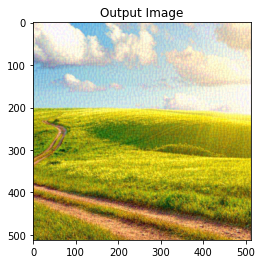

run [150]:
Style Loss : 876.332825 Style-Second Loss : 734.199280 Content Loss: 12.339001



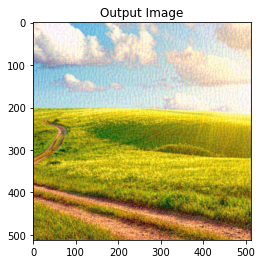

run [200]:
Style Loss : 873.212097 Style-Second Loss : 675.101257 Content Loss: 13.135836



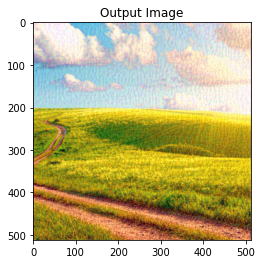

run [250]:
Style Loss : 873.108521 Style-Second Loss : 624.465393 Content Loss: 13.726480



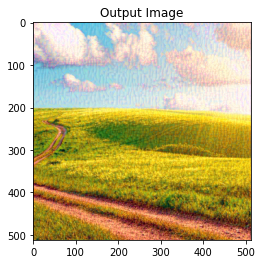

run [300]:
Style Loss : 874.723938 Style-Second Loss : 578.582458 Content Loss: 14.192945



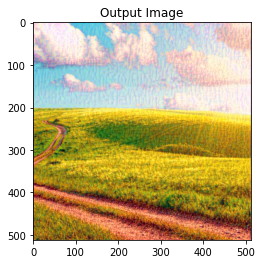

run [350]:
Style Loss : 877.331970 Style-Second Loss : 535.932678 Content Loss: 14.587090



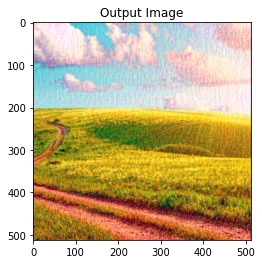

run [400]:
Style Loss : 880.700195 Style-Second Loss : 496.089386 Content Loss: 14.927217



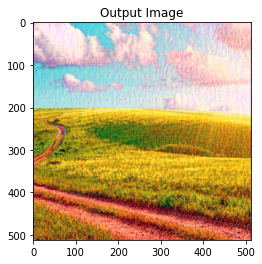

run [450]:
Style Loss : 884.778870 Style-Second Loss : 459.196655 Content Loss: 15.226330



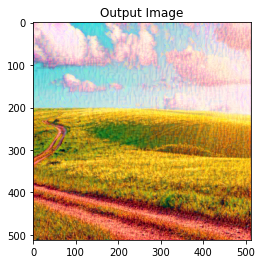

run [500]:
Style Loss : 889.464539 Style-Second Loss : 425.728851 Content Loss: 15.481209



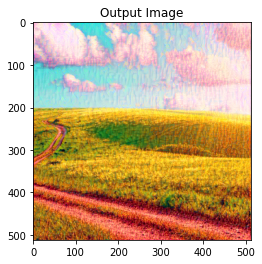

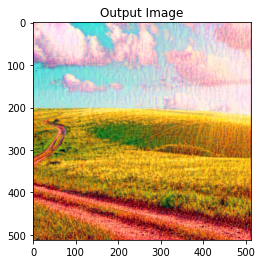

In [26]:
input_img = content_img.clone()
# if you want to use white noise instead uncomment the below line:
#input_img = torch.randn(content_img.data.size(), device=device)

# add the original input image to the figure:
plt.figure()
imshow(input_img, title='Input Image')
output = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, style_img_second, input_img, alpha_coefficient=0.8)

plt.figure()
imshow(output, title='Output Image')
#plt.imsave(output, 'output.png')
# sphinx_gallery_thumbnail_number = 4
plt.ioff()
plt.show()

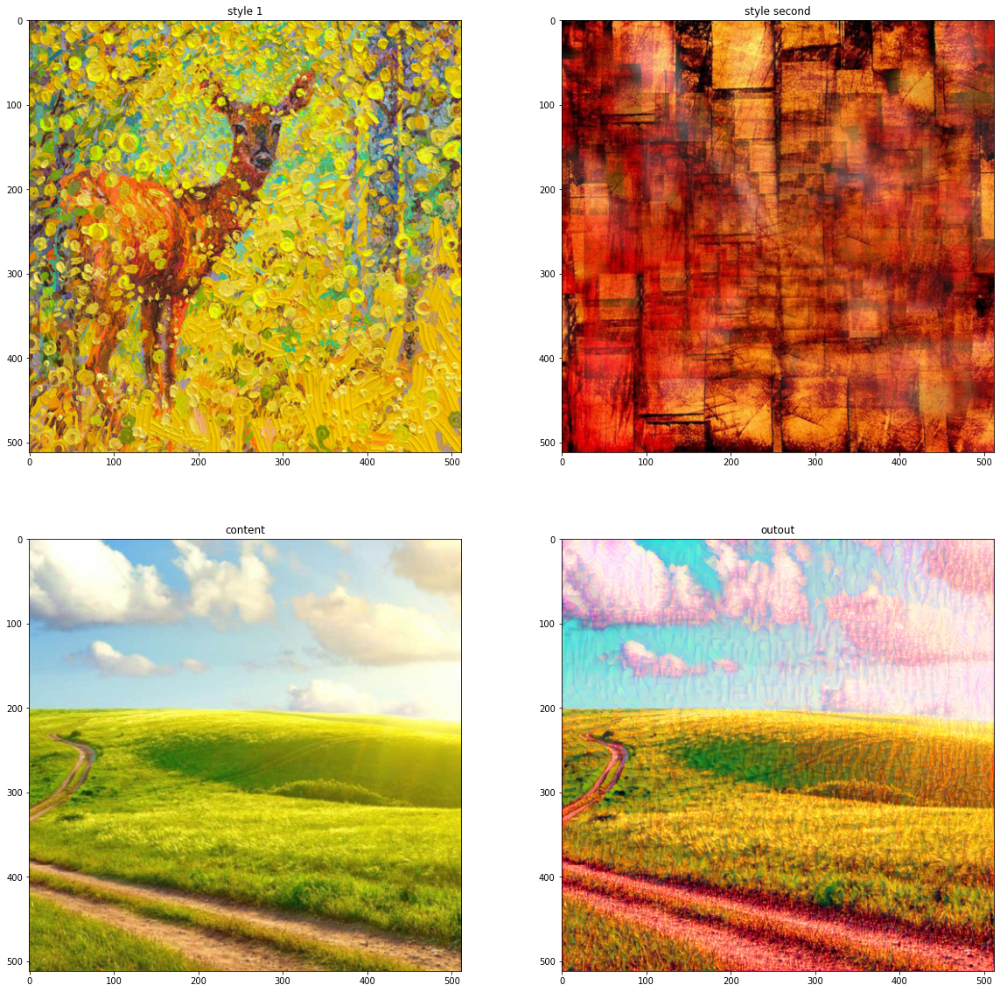

In [27]:
fig = plt.figure(figsize=(20,20), )

plt.subplot(2, 2, 1)
plt.title('style 1')
plt.imshow(tensor_to_matrix(style_img))

plt.subplot(2, 2, 2)
plt.title('style second')
plt.imshow(tensor_to_matrix(style_img_second))

plt.subplot(2, 2, 3)
plt.title('content')
plt.imshow(tensor_to_matrix(content_img))

plt.subplot(2, 2, 4)
plt.title('outout')
plt.imshow(tensor_to_matrix(output))


plt.ioff()
plt.show()

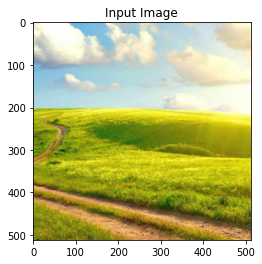

Building the style transfer model..
Optimizing..


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  import sys
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  


run [50]:
Style Loss : 1230.900635 Style-Second Loss : 1244.217041 Content Loss: 10.911267



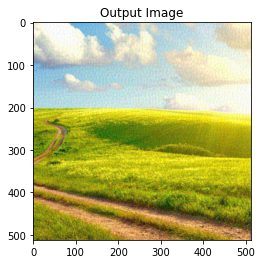

run [100]:
Style Loss : 1008.813660 Style-Second Loss : 1211.181152 Content Loss: 15.232370



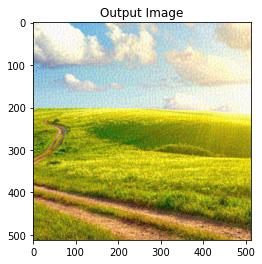

run [150]:
Style Loss : 951.139465 Style-Second Loss : 1189.330566 Content Loss: 16.655033



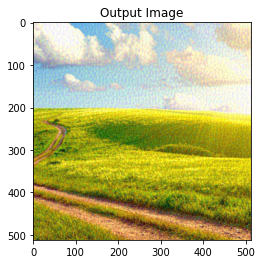

run [200]:
Style Loss : 919.931030 Style-Second Loss : 1170.370239 Content Loss: 17.606606



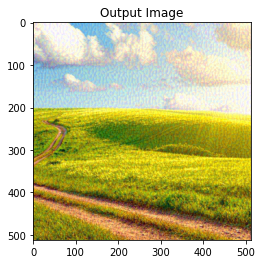

run [250]:
Style Loss : 901.607971 Style-Second Loss : 1153.003662 Content Loss: 18.274731



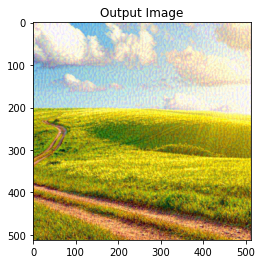

run [300]:
Style Loss : 890.606934 Style-Second Loss : 1137.222290 Content Loss: 18.763252



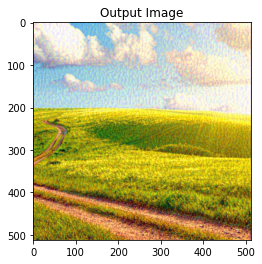

run [350]:
Style Loss : 884.150452 Style-Second Loss : 1122.629639 Content Loss: 19.124725



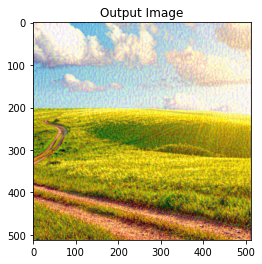

run [400]:
Style Loss : 880.490173 Style-Second Loss : 1109.018311 Content Loss: 19.395660



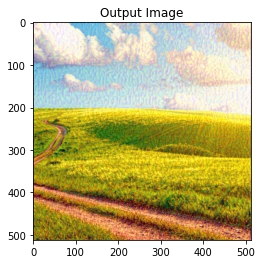

run [450]:
Style Loss : 878.596680 Style-Second Loss : 1096.224854 Content Loss: 19.601089



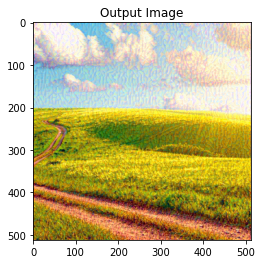

run [500]:
Style Loss : 877.889526 Style-Second Loss : 1084.101440 Content Loss: 19.763254



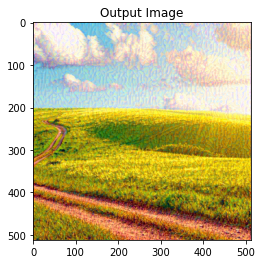

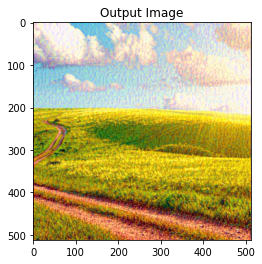

In [28]:
input_img = content_img.clone()
# if you want to use white noise instead uncomment the below line:
#input_img = torch.randn(content_img.data.size(), device=device)

# add the original input image to the figure:
plt.figure()
imshow(input_img, title='Input Image')
output = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, style_img_second, input_img, alpha_coefficient=0.5)

plt.figure()
imshow(output, title='Output Image')
#plt.imsave(output, 'output.png')
# sphinx_gallery_thumbnail_number = 4
plt.ioff()
plt.show()

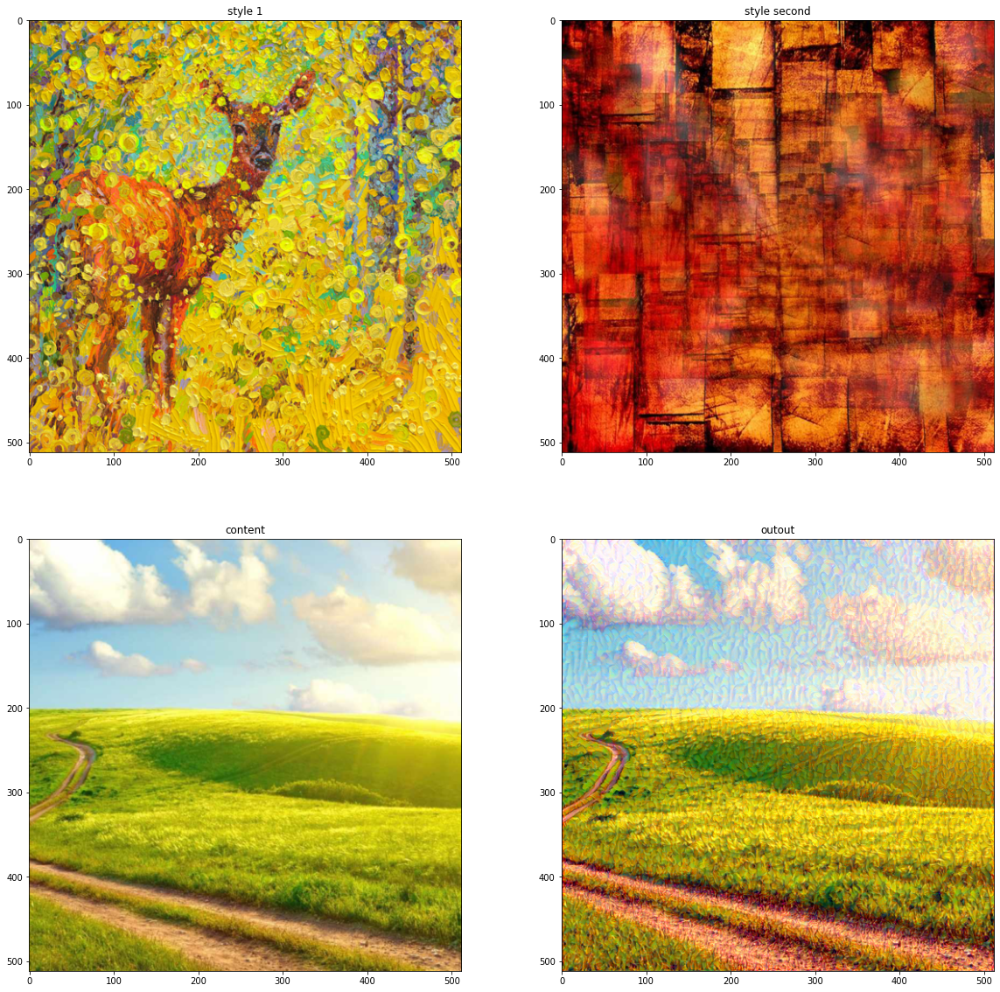

In [29]:
fig = plt.figure(figsize=(20,20), )

plt.subplot(2, 2, 1)
plt.title('style 1')
plt.imshow(tensor_to_matrix(style_img))

plt.subplot(2, 2, 2)
plt.title('style second')
plt.imshow(tensor_to_matrix(style_img_second))

plt.subplot(2, 2, 3)
plt.title('content')
plt.imshow(tensor_to_matrix(content_img))

plt.subplot(2, 2, 4)
plt.title('outout')
plt.imshow(tensor_to_matrix(output))


plt.ioff()
plt.show()

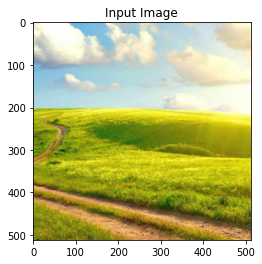

Building the style transfer model..
Optimizing..


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:7: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  import sys
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:8: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  


run [50]:
Style Loss : 1337.675293 Style-Second Loss : 846.017090 Content Loss: 12.688255



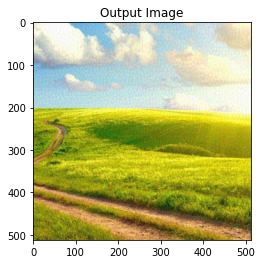

run [100]:
Style Loss : 641.673279 Style-Second Loss : 945.546265 Content Loss: 19.223042



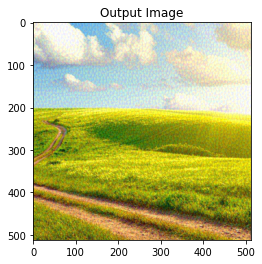

run [150]:
Style Loss : 488.399384 Style-Second Loss : 970.714966 Content Loss: 21.718788



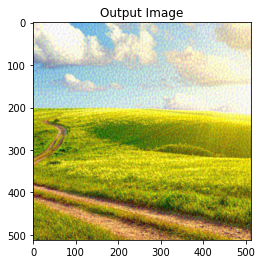

run [200]:
Style Loss : 417.226746 Style-Second Loss : 976.733887 Content Loss: 23.061228



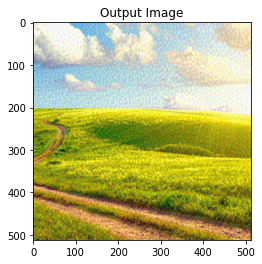

run [250]:
Style Loss : 372.964020 Style-Second Loss : 978.530273 Content Loss: 24.004669



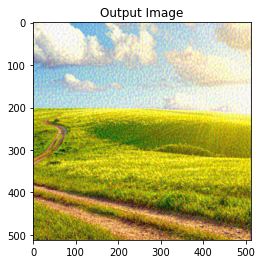

run [300]:
Style Loss : 342.738251 Style-Second Loss : 978.771667 Content Loss: 24.697289



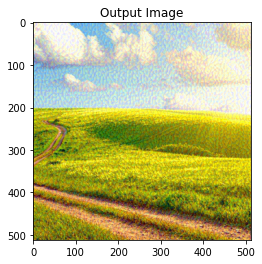

run [350]:
Style Loss : 321.318207 Style-Second Loss : 978.219055 Content Loss: 25.208452



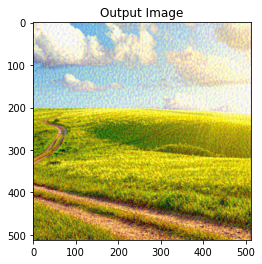

run [400]:
Style Loss : 305.752075 Style-Second Loss : 977.258240 Content Loss: 25.588253



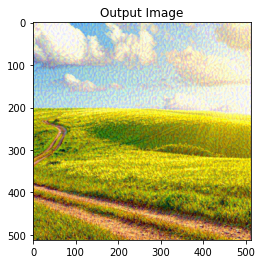

run [450]:
Style Loss : 294.250977 Style-Second Loss : 976.054504 Content Loss: 25.866764



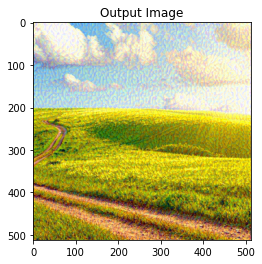

run [500]:
Style Loss : 285.593109 Style-Second Loss : 974.714233 Content Loss: 26.069942



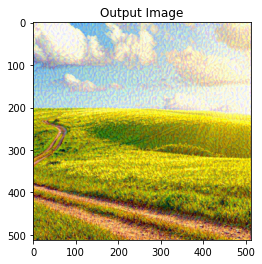

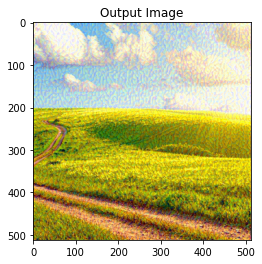

In [30]:
input_img = content_img.clone()
# if you want to use white noise instead uncomment the below line:
#input_img = torch.randn(content_img.data.size(), device=device)

# add the original input image to the figure:
plt.figure()
imshow(input_img, title='Input Image')
output = run_style_transfer(cnn, cnn_normalization_mean, cnn_normalization_std,
                            content_img, style_img, style_img_second, input_img, alpha_coefficient=0.2)

plt.figure()
imshow(output, title='Output Image')
#plt.imsave(output, 'output.png')
# sphinx_gallery_thumbnail_number = 4
plt.ioff()
plt.show()

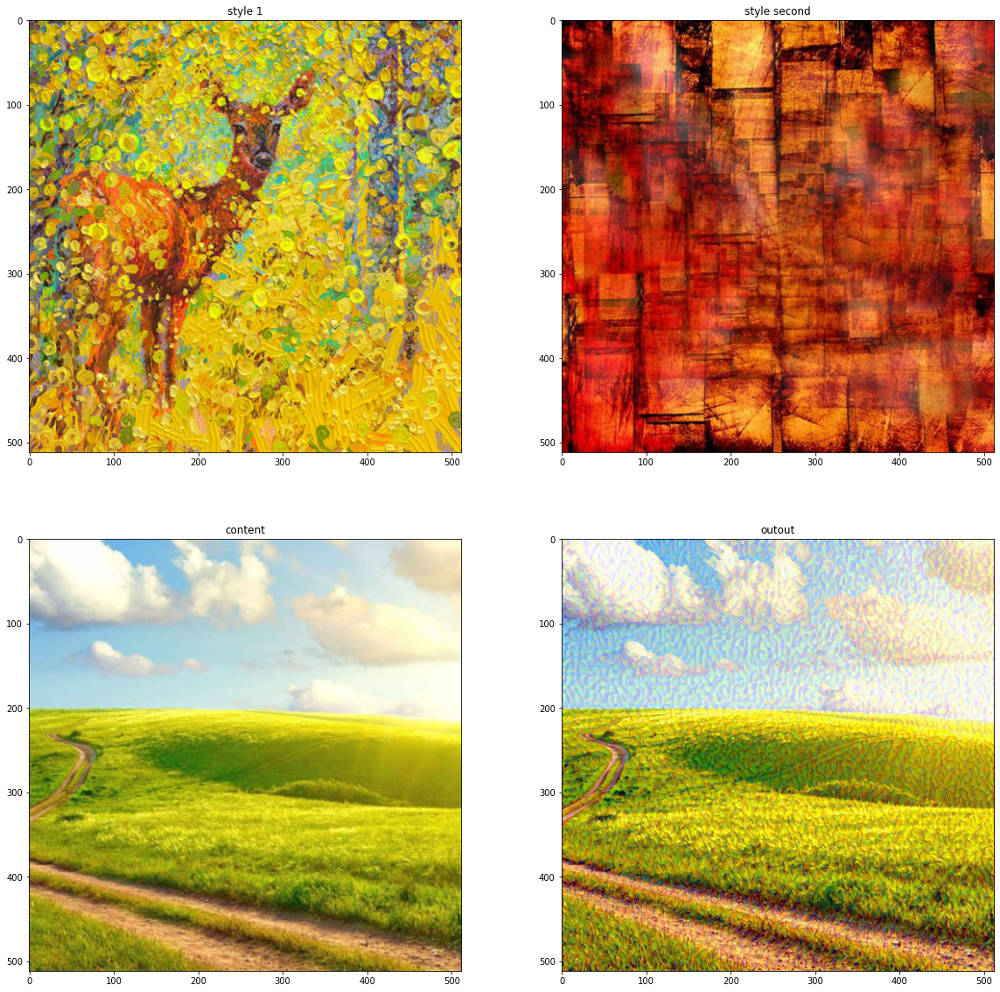

In [31]:
fig = plt.figure(figsize=(20,20), )

plt.subplot(2, 2, 1)
plt.title('style 1')
plt.imshow(tensor_to_matrix(style_img))

plt.subplot(2, 2, 2)
plt.title('style second')
plt.imshow(tensor_to_matrix(style_img_second))

plt.subplot(2, 2, 3)
plt.title('content')
plt.imshow(tensor_to_matrix(content_img))

plt.subplot(2, 2, 4)
plt.title('outout')
plt.imshow(tensor_to_matrix(output))


plt.ioff()
plt.show()